# Simulation using Concord

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import scanpy as sc
import time
from pathlib import Path
import torch
import Concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [3]:
proj_name = "simulation_ccd"
save_dir = f"../save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')
print(device)
seed = 0
ccd.ul.set_seed(seed)

cpu


Concord.utils.simulation - INFO - Simulating trajectory with 3 states, distribution: normal with mean expression 10 and dispersion 1.0.
Concord.utils.simulation - INFO - Simulating batch-specific features effect on batch_1 by appending a set of batch-specific genes with normal distributed value with level 10 and dispersion 1.0.
Concord.utils.simulation - INFO - Simulating batch-specific features effect on batch_2 by appending a set of batch-specific genes with normal distributed value with level 10 and dispersion 1.0.


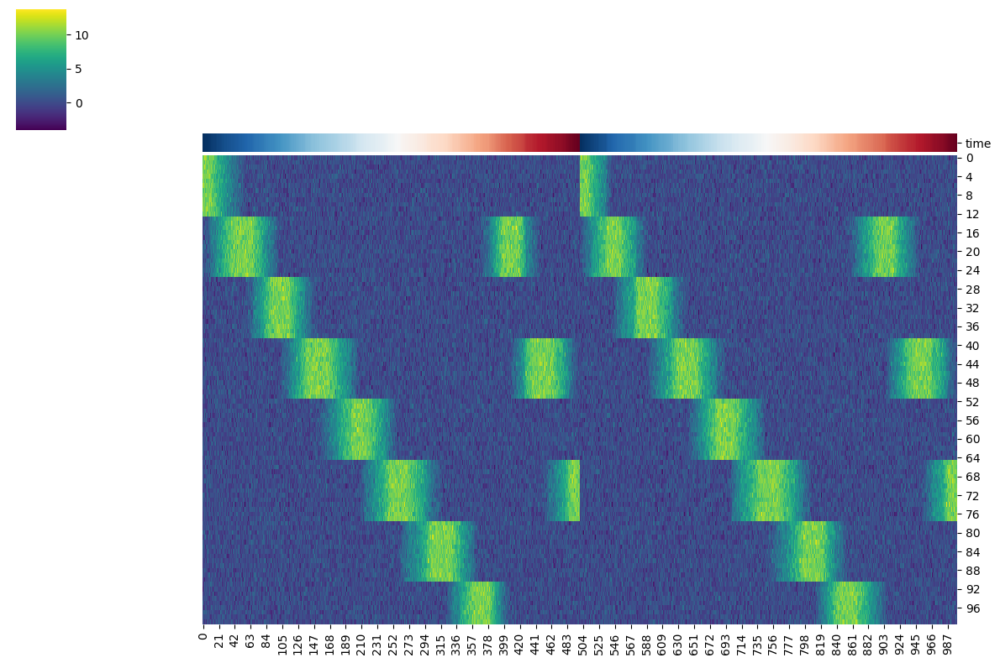

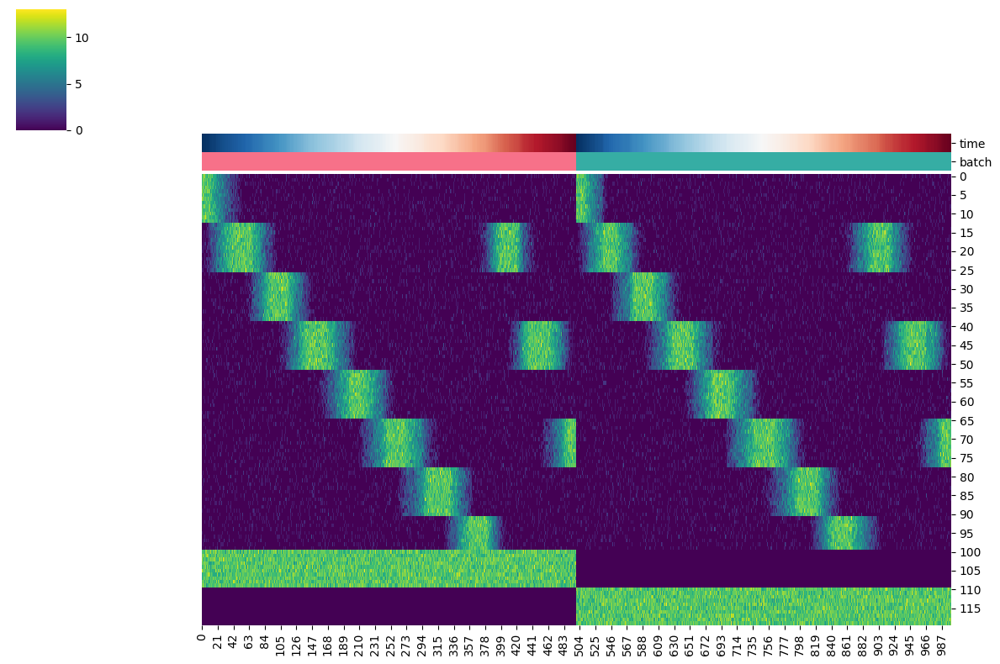

In [239]:
from Concord.utils.simulation import Simulation
#group_key = 'group'
group_key = 'time'
batch_key = 'batch'
state_type = 'trajectory'
batch_type = 'batch_specific_features'
distribution = 'normal'
# Create an instance of the Simulation class

sim = Simulation(n_cells=1000, n_genes=100, n_batches=2, n_states=3, 
                 state_type=state_type, 
                 state_distribution = distribution, 
                 state_level=10, 
                 state_min_level=0,
                 state_dispersion=1.0, 
                 program_structure='linear_bidirectional',
                 program_on_time_fraction=0.2,
                 trajectory_program_num=8,
                 trajectory_cell_block_size_ratio=0.2,
                 trajectory_loop_to=[1,3,5],
                 batch_distribution = distribution,
                 batch_type=batch_type, 
                 batch_level=[10,10], 
                 batch_dispersion=[1.0, 1.0], 
                 non_neg=True, to_int=True,
                 seed=42)

# Generate the simulated data
adata, adata_state = sim.simulate_data()
file_suffix = f"{state_type}_{batch_type}_{distribution}_{time.strftime('%b%d-%H%M')}"
ccd.pl.heatmap_with_annotations(adata_state, val='X', obs_keys=[group_key], cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', save_path=save_dir/f'state_heatmap_{file_suffix}.png') 
ccd.pl.heatmap_with_annotations(adata, val='X', obs_keys=[group_key, batch_key], cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', save_path=save_dir/f'heatmap_{file_suffix}.png') 

### NO batch effect, PCA and UMAP

In [240]:
n_pcs = min(adata_state.n_obs, adata_state.n_vars)-1
sc.pp.pca(adata_state, n_comps=n_pcs)
sc.pp.neighbors(adata_state, n_neighbors=30, n_pcs=n_pcs)
sc.tl.umap(adata_state, min_dist=0.5)

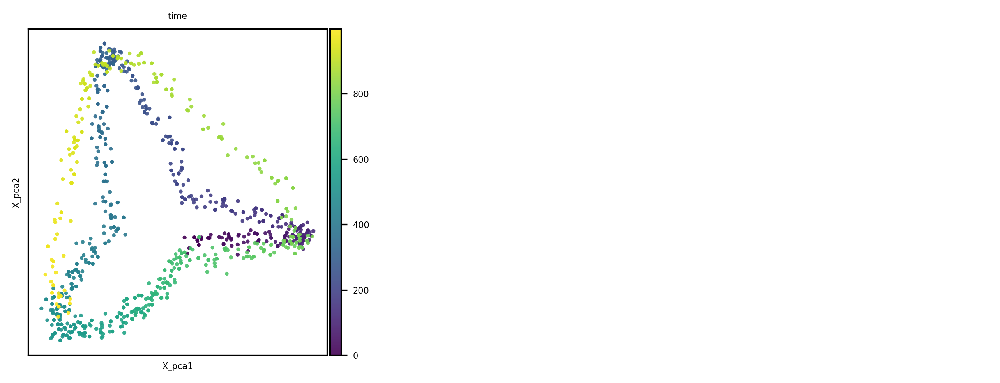

In [241]:
show_basis = 'X_pca'
show_cols = [group_key]

ccd.pl.plot_embedding(
    adata_state, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"nobatch_{show_basis}_{file_suffix}.png"
)

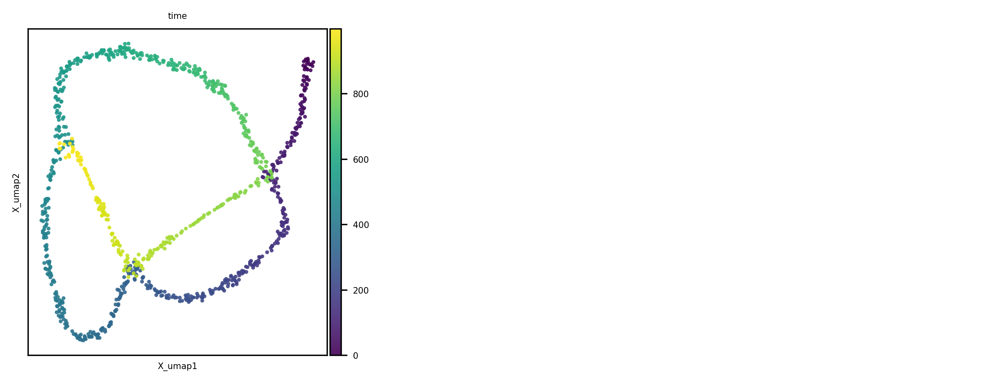

In [242]:
show_basis = 'X_umap'
show_cols = [group_key]

ccd.pl.plot_embedding(
    adata_state, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"nobatch_{show_basis}_{file_suffix}.png"
)

### No batch correction, PCA and UMAP

In [243]:
n_pcs = min(adata.n_obs, adata.n_vars)-1
sc.pp.pca(adata, n_comps=n_pcs)
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=n_pcs)
sc.tl.umap(adata, min_dist=0.5)
adata.obsm["Unintegrated"] = adata.obsm["X_pca"]

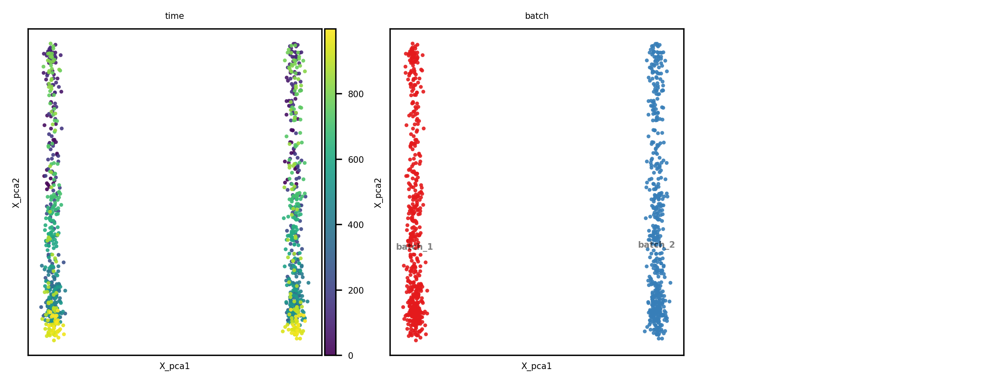

In [244]:
show_basis = 'X_pca'
show_cols = [group_key, batch_key]

ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"wtbatch_{show_basis}_{file_suffix}.png"
)

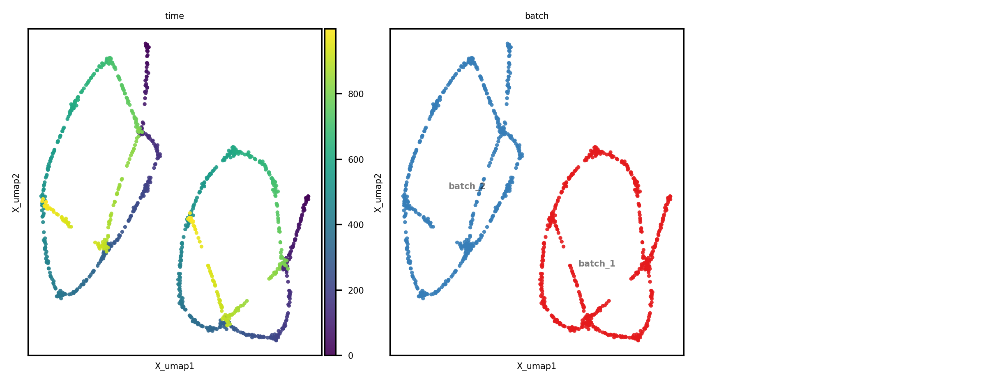

In [245]:
show_basis = 'X_umap'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"wtbatch_{show_basis}_{file_suffix}.png"
)

### Concord

In [11]:
cur_ccd = ccd.Concord(adata=adata, 
                      input_feature=None, 
                      batch_size=32,
                      n_epochs=10,
                      lr=1e-2,
                      train_frac=1.0,
                      schedule_ratio = 0.97,
                      latent_dim=32, # latent dimension
                      encoder_dims = [64], # encoder architecture
                      decoder_dims = [64], # decoder architecture
                      norm_type = 'layer_norm',
                      use_importance_mask=False,
                      #importance_penalty_weight=1.0,
                      use_decoder=False,
                      domain_embedding_dim=8,
                      domain_key=batch_key, # key indicating batch
                      augmentation_mask_prob = 0.5, # augmentation mask probability, recommend between 0.1 and 0.7
                      clr_temperature = 0.5, # temperature for NT-Xent loss
                      seed=seed, # random seed
                      p_intra_domain = 1.0, # probability of intra-domain sampling
                      p_intra_knn=0.3,
                      sampler_knn = 128,
                      verbose=True, # print training progress
                      inplace=True, # whether to modify original adata, set to False if you want to keep all expressions
                      device=device, # device to run on
                      save_dir=save_dir # directory to save model checkpoints
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - INFO - Proceeding with all 120 features in the dataset.
Concord - INFO - Column 'batch' is already of type: category
Concord - INFO - Unused levels dropped for column 'batch'.
Concord - INFO - Encoder input dim: 120
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 10032
Concord.model.anndataset - INFO - Initialized dataset with 1000 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'X_pca' from adata.obsm
Concord.model.knn - WARNING - FAISS not found. Using sklearn for k-NN computation.
Concord.model.dataloader - INFO - Number of unique_domains: 2
Concord.model.dataloader - INFO - Final p_intra_domain values: batch_1: 1.00, batch_2: 1.00
p_intra_knn: 0.3
Concord - INFO - Starting epoch 1/10
Concord - INFO - Processing chunk 1/1 for e

Epoch 0 Training: 30it [00:00, 96.90it/s, loss=3.26]

Concord - INFO - Epoch   0 | Train Loss: 3.41, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.41, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/10
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 1 Training: 100%|██████████| 30/30 [00:00<00:00, 101.99it/s, loss=3]  

Concord - INFO - Epoch   1 | Train Loss: 3.06, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.06, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/10
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 2 Training: 100%|██████████| 30/30 [00:00<00:00, 141.09it/s, loss=2.9] 

Concord - INFO - Epoch   2 | Train Loss: 2.98, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.98, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/10
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 3 Training: 100%|██████████| 30/30 [00:00<00:00, 108.11it/s, loss=2.75]

Concord - INFO - Epoch   3 | Train Loss: 2.91, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.91, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/10
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 4 Training: 100%|██████████| 30/30 [00:00<00:00, 121.59it/s, loss=2.84]

Concord - INFO - Epoch   4 | Train Loss: 2.87, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.87, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/10
Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 5 Training: 100%|██████████| 30/30 [00:00<00:00, 149.51it/s, loss=2.8] 

Concord - INFO - Epoch   5 | Train Loss: 2.84, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.84, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/10
Concord - INFO - Processing chunk 1/1 for epoch 7
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 6 Training: 100%|██████████| 30/30 [00:00<00:00, 102.55it/s, loss=2.78]

Concord - INFO - Epoch   6 | Train Loss: 2.85, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.85, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 8/10
Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 7 Training: 100%|██████████| 30/30 [00:00<00:00, 142.30it/s, loss=2.77]

Concord - INFO - Epoch   7 | Train Loss: 2.83, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.83, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/10
Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 8 Training: 100%|██████████| 30/30 [00:00<00:00, 109.33it/s, loss=2.8]

Concord - INFO - Epoch   8 | Train Loss: 2.83, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.83, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 10/10
Concord - INFO - Processing chunk 1/1 for epoch 10


Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 9 Training: 100%|██████████| 30/30 [00:00<00:00, 96.98it/s, loss=2.8] 

Concord - INFO - Epoch   9 | Train Loss: 2.81, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.81, IMPORTANCE: 0.00
Concord - INFO - Model saved to ../save/dev_simulation_ccd-Oct27/final_model.pth
Concord - INFO - Final model saved at: ../save/dev_simulation_ccd-Oct27/final_model.pth; Configuration saved at: ../save/dev_simulation_ccd-Oct27/config.json.
Concord.model.anndataset - INFO - Initialized dataset with 1000 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1


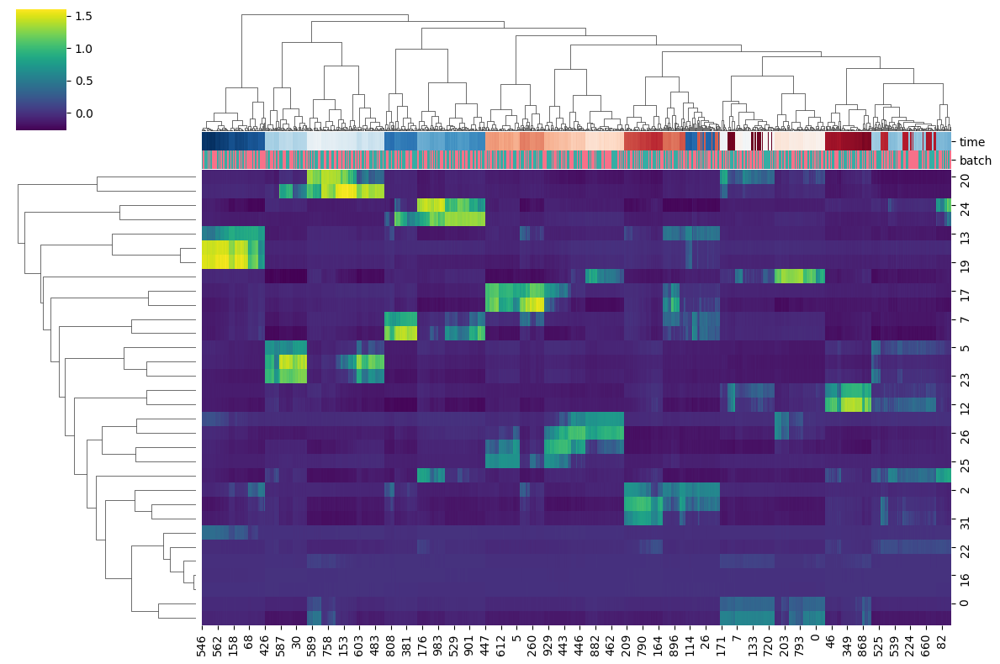

In [12]:
ccd.pl.heatmap_with_annotations(adata, val='Concord', obs_keys=[group_key, batch_key], cluster_cols=True, cluster_rows=True, cmap='viridis', save_path=save_dir/f'Concord_latent_heatmap_{file_suffix}.png')

# Show neuron number usage with increased number

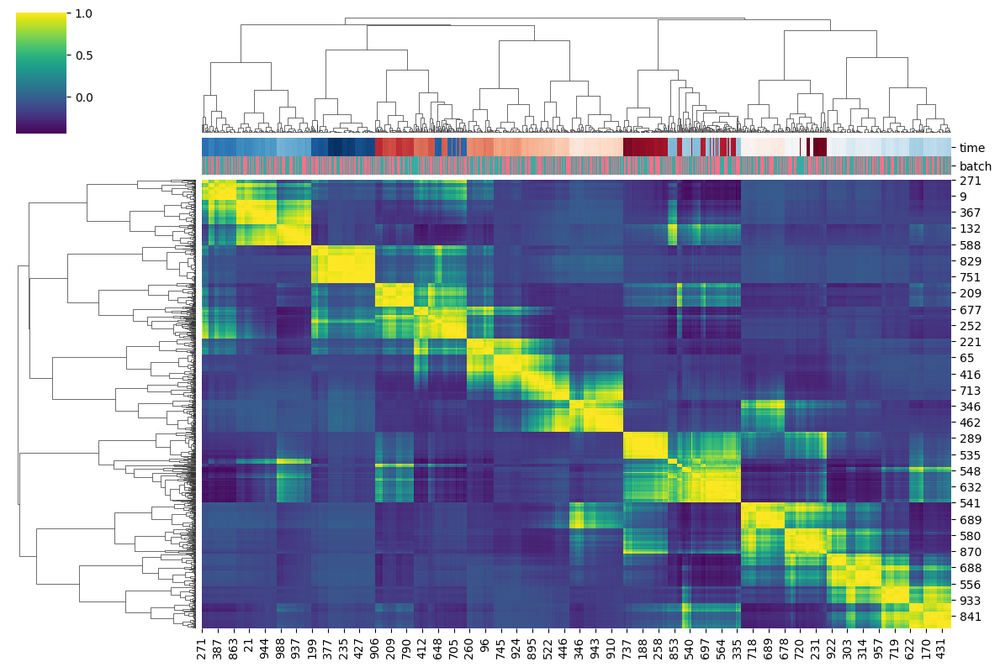

In [13]:
# Compute the correlation matrix
cos_mtx = ccd.ul.cosine_sim(adata.obsm['Concord'])
ccd.pl.heatmap_with_annotations(adata, val=cos_mtx,
                                obs_keys=[group_key, batch_key], cluster_cols=True, cluster_rows=True, cmap='viridis', save_path=save_dir/f'Concord_cosine_{file_suffix}.png')

Concord - INFO - PCA performed on source data with 31 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_PCA']


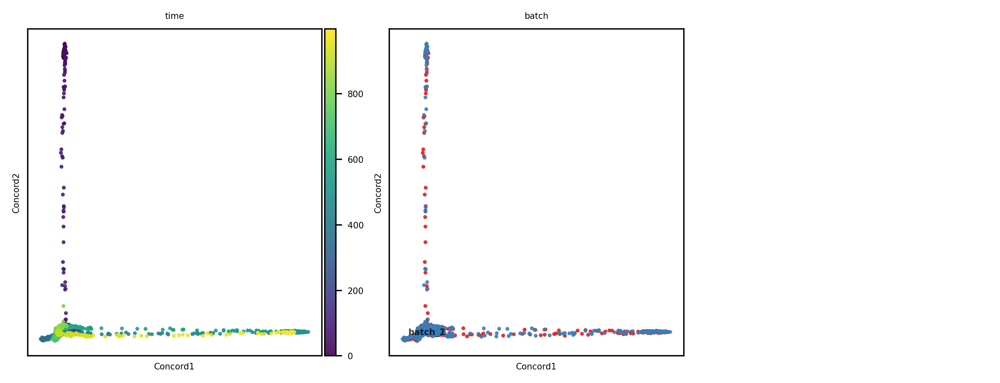

In [14]:
n_pc = min(adata.obsm[output_key].shape[1], adata.shape[0]) - 1
ccd.ul.run_pca(adata, source_key=output_key, result_key=f'{output_key}_PCA', n_pc=n_pc, random_state=seed)
show_basis = f'{output_key}'
show_cols = [group_key, batch_key]
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


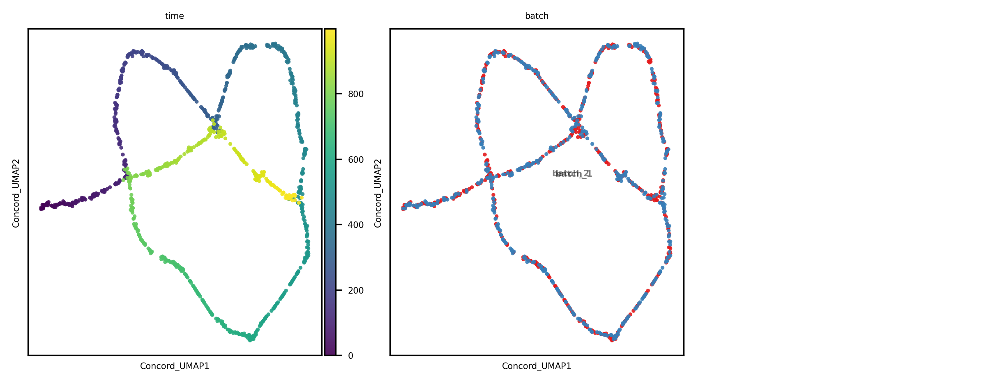

In [15]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
output_key = 'Concord'
show_basis = f'{output_key}_UMAP'
show_cols = [group_key, batch_key]
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [16]:
ccd.ul.run_umap(adata, source_key='Concord', umap_key='Concord_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
ccd.pl.plot_embedding_3d(
    adata, basis='Concord_UMAP_3D', color_by=show_cols,
    save_path= save_dir / f"{show_basis}_{file_suffix}.html",
    point_size=5, opacity=0.8, width=1500, height=1000
)

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP_3D']
Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd-Oct27/Concord_UMAP_trajectory_batch_specific_features_normal_Oct27-1250_time.html


Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd-Oct27/Concord_UMAP_trajectory_batch_specific_features_normal_Oct27-1250_batch.html


## Evaluation

### 1. Topological properties

#### 1.0 Persistent homology

In [116]:
adata.obsm

AxisArrays with keys: X_pca, X_umap, Unintegrated, Concord, Concord_PCA, Concord_UMAP, Concord_UMAP_3D

In [117]:
# Not run, using giotto-tda instead of ripser
import numpy as np
from ripser import ripser
from persim import plot_diagrams
print("Computing persistence diagram for the state data")
ripser_original = ripser(adata_state.obsm['X_pca'])
print("Computing persistence diagram for the data with batch effect")
ripser_batch = ripser(adata.obsm['X_pca'])
print("Computing persistence diagram for the Concord latent on data with batch effect")
ripser_concord = ripser(adata.obsm['Concord'])
# Plot the persistence diagrams for the 3 datasets side by side
import matplotlib.pyplot as plt
plt.figure(figsize=(15,5))
plt.subplot(131)
plot_diagrams(ripser_original['dgms'], title='Original Data')
plt.subplot(132)
plot_diagrams(ripser_batch['dgms'], title='Data with Batch Effect')
plt.subplot(133)
plot_diagrams(ripser_concord['dgms'], title='Concord Latent')
plt.tight_layout()
plt.savefig(save_dir / f"persistence_diagrams_{file_suffix}.png")

Computing persistence diagram for the state data
Computing persistence diagram for the data with batch effect
Computing persistence diagram for the Concord latent on data with batch effect


In [229]:
import importlib
importlib.reload(ccd)

<module 'Concord' from '/Users/qinzhu/opt/anaconda3/envs/concord/lib/python3.9/site-packages/Concord/__init__.py'>

In [18]:
# Compute persistence diagram
#from Concord.utils.persistent_homology import compute_persistent_homology
homology_dimensions = [0,1,2]
dg_state = ccd.ul.compute_persistent_homology(adata_state, key='X_pca', homology_dimensions=homology_dimensions)
dg_pca = ccd.ul.compute_persistent_homology(adata, key='X_pca', homology_dimensions=homology_dimensions)
dg_ccd = ccd.ul.compute_persistent_homology(adata, key='Concord', homology_dimensions=homology_dimensions)

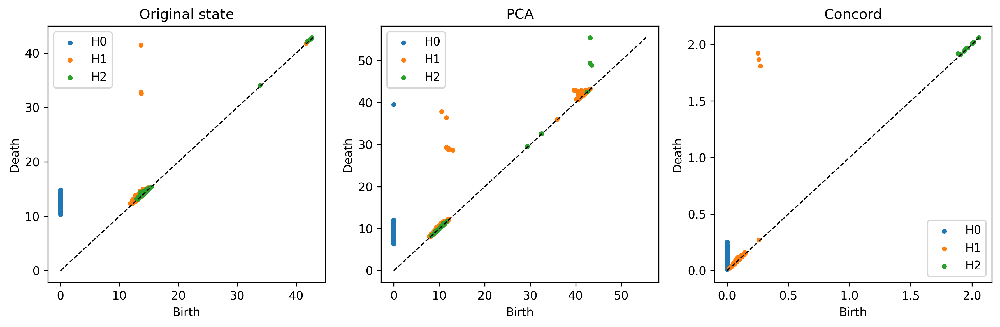

In [33]:
from matplotlib import pyplot as plt
fig, ax = plt.subplots(figsize=(12,4), ncols=3, dpi=300)
ccd.ul.plot_persistence_diagram(dg_state[0], ax=ax[0], marker_size=10, title='Original state', show=False)
ccd.ul.plot_persistence_diagram(dg_pca[0], ax=ax[1], marker_size=10, title='PCA', show=False)
ccd.ul.plot_persistence_diagram(dg_ccd[0], ax=ax[2], marker_size=10, title='Concord', show=False)
plt.tight_layout()
plt.savefig(save_dir / f"persistence_diagrams_{file_suffix}.png")
plt.show()

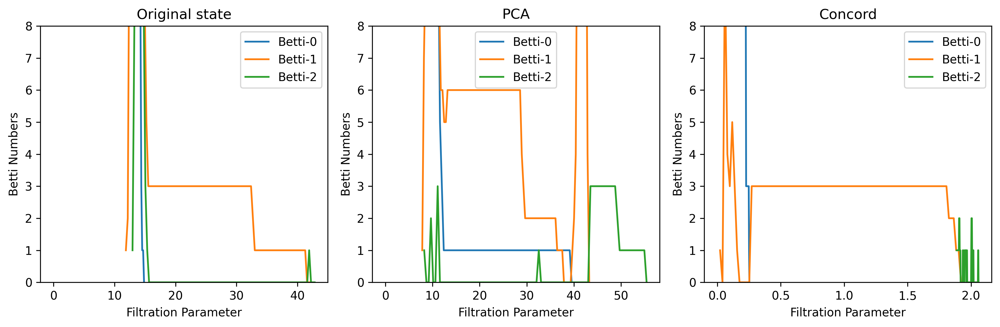

In [41]:
fig, ax = plt.subplots(figsize=(12,4), ncols=3, dpi=300)
ccd.ul.plot_betti_curves(dg_state, nbins=100, ax=ax[0], ymax=8, title='Original state', show=False)
ccd.ul.plot_betti_curves(dg_pca, nbins=100, ax=ax[1], ymax=8, title='PCA', show=False)
ccd.ul.plot_betti_curves(dg_ccd, nbins=100, ax=ax[2], ymax=8, title='Concord', show=False)
plt.tight_layout()
plt.savefig(save_dir / f"betti_curves_{file_suffix}.png")
plt.show()

In [43]:
from gtda.diagrams import PersistenceEntropy

PE = PersistenceEntropy()
pe_state = PE.fit_transform(dg_state)
pe_pca = PE.fit_transform(dg_pca)
pe_ccd = PE.fit_transform(dg_ccd)

print(f"PE state: {pe_state}, PE PCA: {pe_pca}, PE Concord: {pe_ccd}")

PE state: [[9.96272808 8.03568817 7.39361499]], PE PCA: [[9.95375537 6.21889537 2.43963157]], PE Concord: [[9.73337264 2.51338674 2.78638894]]


In [71]:
input_dim = 3
layout_dim = 2
color_by = 'time'
cover_n_intervals = 20
cover_overlap_frac = 0.5
cluster_eps = 0.5
node_scale=30

basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
basis = 'Concord'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

In [92]:
adata_state.obs['batch_numeric'] = 0
adata.obs['batch_numeric'] = adata.obs['batch'].astype('category').cat.codes

input_dim = 3
layout_dim = 2
color_by = 'batch_numeric'
cover_n_intervals = 20
cover_overlap_frac = 0.5
cluster_eps = 0.5
node_scale=30
cmap = 'RdBu'

basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
basis = 'Concord'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

In [73]:
input_dim = 3
layout_dim = 3
color_by = 'time'
cover_n_intervals = 20
cover_overlap_frac = 0.5
cluster_eps = 0.5
node_scale=30

basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
basis = 'Concord'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

In [93]:
adata_state.obs['batch_numeric'] = 0
adata.obs['batch_numeric'] = adata.obs['batch'].astype('category').cat.codes

input_dim = 3
layout_dim = 3
color_by = 'batch_numeric'
cover_n_intervals = 20
cover_overlap_frac = 0.5
cluster_eps = 0.5
node_scale=30
cmap = 'RdBu'

basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
basis = 'Concord'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

In [ ]:
adata_state.obs['batch_numeric'] = 0
adata.obs['batch_numeric'] = adata.obs['batch'].astype('category').cat.codes

input_dim = 3
layout_dim = 3
color_by = 'batch_numeric'
cover_n_intervals = 20
cover_overlap_frac = 0.5
cluster_eps = 0.5
node_scale=30
cmap = 'RdBu'

basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
basis = 'Concord'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

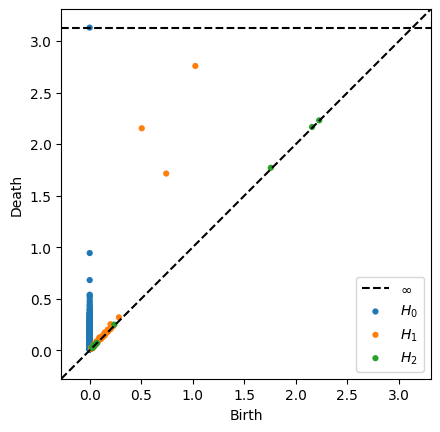

Betti numbers (at infinity): [1, 0, 0]


In [74]:
# NOT RUN, using giotto-tda instead of ripser
import numpy as np
from ripser import ripser
from persim import plot_diagrams
from persim import wasserstein, bottleneck

# Compute distances between persistence diagrams
distance = bottleneck(diagrams_original[1], diagrams_latent[1])
print(f'Bottleneck Distance: {distance}')

# Step 1: Compute persistent homology
results = ripser(latent_data, maxdim=2)

# Step 2: Extract persistence diagrams
diagrams = results['dgms']

# Step 3: Plot persistence diagrams
plot_diagrams(diagrams, show=True)

# Step 4: Extract Betti numbers at a specific scale (e.g., at infinity)
betti_numbers = []
for i, dgm in enumerate(diagrams):
    num_infinite_barcodes = np.sum(np.isinf(dgm[:, 1]))
    betti_numbers.append(num_infinite_barcodes)
    
print(f"Betti numbers (at infinity): {betti_numbers}")

### 2. Geometric properties

#### 2.0 Latent intepretation

In [318]:
cur_ccd = ccd.Concord(adata=adata, 
                      input_feature=None, 
                      batch_size=32,
                      n_epochs=10,
                      lr=1e-2,
                      train_frac=1.0,
                      schedule_ratio = 0.97,
                      latent_dim=32, # latent dimension
                      encoder_dims = [64], # encoder architecture
                      decoder_dims = [64], # decoder architecture
                      norm_type = 'layer_norm',
                      use_importance_mask=False,
                      #importance_penalty_weight=1.0,
                      use_decoder=True,
                      domain_embedding_dim=8,
                      domain_key=batch_key, # key indicating batch
                      augmentation_mask_prob = 0.5, # augmentation mask probability, recommend between 0.1 and 0.7
                      clr_temperature = 0.5, # temperature for NT-Xent loss
                      seed=seed, # random seed
                      p_intra_domain = 1.0, # probability of intra-domain sampling
                      p_intra_knn=0.5,
                      sampler_knn = 128,
                      verbose=True, # print training progress
                      inplace=True, # whether to modify original adata, set to False if you want to keep all expressions
                      device=device, # device to run on
                      save_dir=save_dir # directory to save model checkpoints
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False, return_latent=True, return_decoded=True, decoder_domain='batch_1')
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - INFO - Proceeding with all 120 features in the dataset.
Concord - INFO - Column 'batch' is already of type: category
Concord - INFO - Unused levels dropped for column 'batch'.
Concord - INFO - Encoder input dim: 120
Concord - INFO - Decoder input dim: 40
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 20584
Concord.model.anndataset - INFO - Initialized dataset with 1000 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'X_pca' from adata.obsm
Concord.model.knn - WARNING - FAISS not found. Using sklearn for k-NN computation.
Concord.model.dataloader - INFO - Number of unique_domains: 2
Concord.model.dataloader - INFO - Final p_intra_domain values: batch_1: 1.00, batch_2: 1.00
p_intra_knn: 0.5
Concord - INFO - Starting epoch 1/10
Conc

Epoch 0 Training: 30it [00:00, 90.17it/s, loss=9.26] 


Concord - INFO - Epoch   0 | Train Loss:13.92, MSE:10.24, CLASS: 0.00, CONTRAST: 3.68, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/10
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 1 Training: 100%|██████████| 30/30 [00:00<00:00, 110.96it/s, loss=5.79]

Concord - INFO - Epoch   1 | Train Loss: 6.59, MSE: 3.30, CLASS: 0.00, CONTRAST: 3.29, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/10


Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 2 Training: 100%|██████████| 30/30 [00:00<00:00, 78.07it/s, loss=5.35]

Concord - INFO - Epoch   2 | Train Loss: 5.24, MSE: 2.04, CLASS: 0.00, CONTRAST: 3.20, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/10
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 3 Training: 100%|██████████| 30/30 [00:00<00:00, 90.89it/s, loss=4.51] 

Concord - INFO - Epoch   3 | Train Loss: 4.91, MSE: 1.74, CLASS: 0.00, CONTRAST: 3.18, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/10
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 4 Training: 100%|██████████| 30/30 [00:00<00:00, 106.98it/s, loss=4.36]

Concord - INFO - Epoch   4 | Train Loss: 4.79, MSE: 1.66, CLASS: 0.00, CONTRAST: 3.12, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 6/10
Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 5 Training: 100%|██████████| 30/30 [00:00<00:00, 68.43it/s, loss=4.23]

Concord - INFO - Epoch   5 | Train Loss: 4.69, MSE: 1.56, CLASS: 0.00, CONTRAST: 3.13, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/10
Concord - INFO - Processing chunk 1/1 for epoch 7


Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 6 Training: 100%|██████████| 30/30 [00:00<00:00, 90.03it/s, loss=5.01] 

Concord - INFO - Epoch   6 | Train Loss: 4.57, MSE: 1.51, CLASS: 0.00, CONTRAST: 3.07, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 8/10


Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 7 Training: 100%|██████████| 30/30 [00:00<00:00, 89.59it/s, loss=4.83]

Concord - INFO - Epoch   7 | Train Loss: 4.51, MSE: 1.47, CLASS: 0.00, CONTRAST: 3.04, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/10
Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 8 Training: 100%|██████████| 30/30 [00:00<00:00, 122.68it/s, loss=4.8] 

Concord - INFO - Epoch   8 | Train Loss: 4.48, MSE: 1.47, CLASS: 0.00, CONTRAST: 3.01, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 10/10
Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 9 Training: 100%|██████████| 30/30 [00:00<00:00, 91.04it/s, loss=3.97] 

Concord - INFO - Epoch   9 | Train Loss: 4.49, MSE: 1.49, CLASS: 0.00, CONTRAST: 3.00, IMPORTANCE: 0.00


Concord - INFO - Model saved to ../save/dev_simulation_ccd-Oct27/final_model.pth
Concord - INFO - Final model saved at: ../save/dev_simulation_ccd-Oct27/final_model.pth; Configuration saved at: ../save/dev_simulation_ccd-Oct27/config.json.
Concord.model.anndataset - INFO - Initialized dataset with 1000 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1
Concord - INFO - Projecting data back to expression space of specified domain: batch_1


In [261]:
adata.layers

Layers with keys: Concord_decoded_batch_2, Concord_decoded_batch_1

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


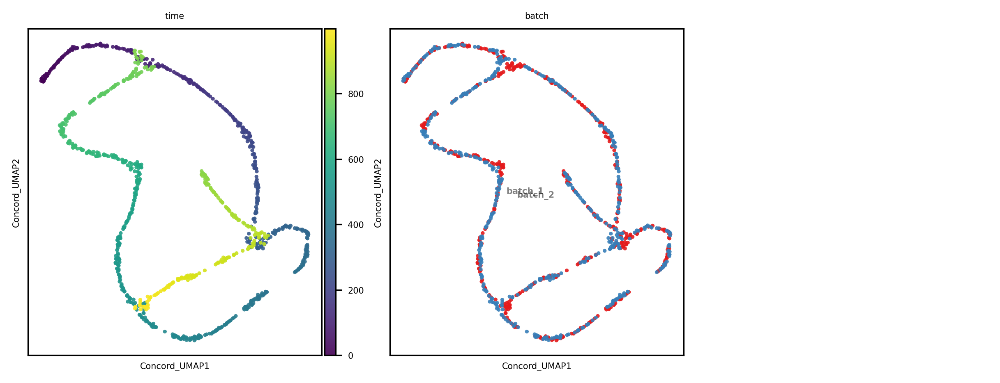

In [319]:
output_key = 'Concord'
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
show_cols = [group_key, batch_key]
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [320]:
# Predict and store the results
#decoder_domain = 'batch_1'
decoder_domain = 'batch_2'
encoded, decoded, class_preds, class_probs, class_true, latent_matrices = cur_ccd.predict(cur_ccd.loader, 
                                                                                        return_decoded=True, decoder_domain=decoder_domain,
                                                                                        return_latent=True,
                                                                                        return_class=False, return_class_prob=False)
save_key = f"{output_key}_decoded_{decoder_domain}"
adata.layers[save_key] = decoded
adata.layers

Concord - INFO - Predicting for chunk 1/1
Concord - INFO - Projecting data back to expression space of specified domain: batch_2


Layers with keys: Concord_decoded_batch_2, Concord_decoded_batch_1, Concord_decoded

In [321]:
adata.obsm

AxisArrays with keys: X_pca, X_umap, Unintegrated, Concord, Concord_encoder_2, Concord_encoder_6, Concord_decoder_2, Concord_decoder_5, Concord_UMAP, Concord_encoder_2_UMAP, Concord_encoder_6_UMAP, Concord_decoder_2_UMAP, Concord_decoder_5_UMAP

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_encoder_2_UMAP']


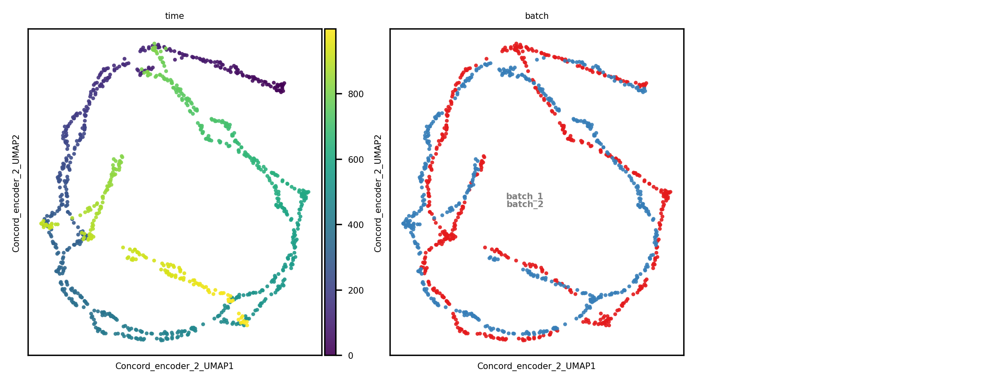

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_encoder_6_UMAP']


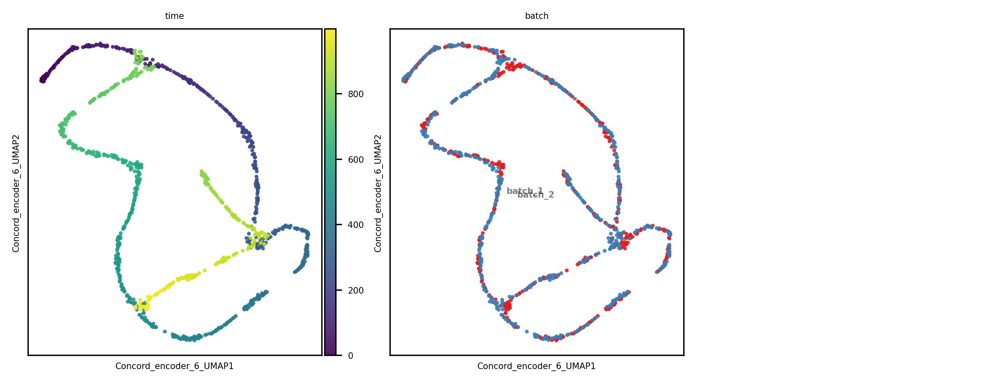

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_decoder_2_UMAP']


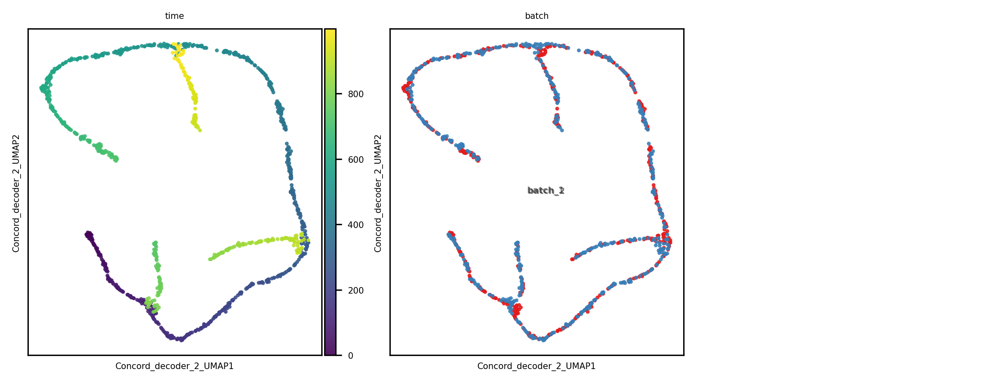

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_decoder_5_UMAP']


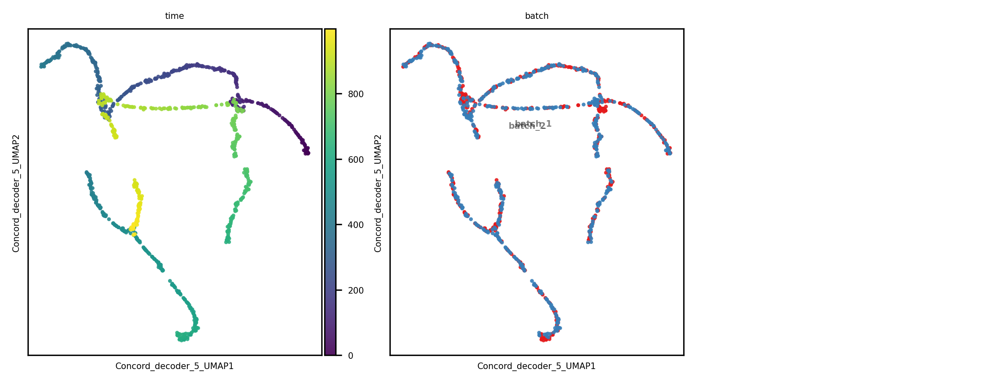

In [322]:
for output_key in ['Concord_encoder_2', 'Concord_encoder_6', 'Concord_decoder_2', 'Concord_decoder_5']:
    ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
    show_basis = f'{output_key}_UMAP'
    show_cols = [group_key, batch_key]
    ccd.pl.plot_embedding(
        adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
        save_path=save_dir / f"{show_basis}_{file_suffix}.png"
    )

#### 2.1 Reconstruction error

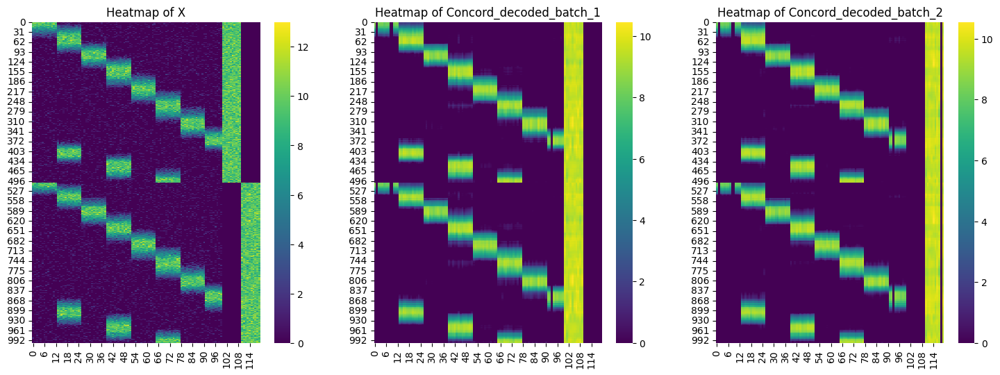

In [323]:
ccd.pl.plot_adata_layer_heatmaps(adata, ncells=None, ngenes=None, layers=['X', 'Concord_decoded_batch_1', 'Concord_decoded_batch_2'], 
                                 obs_keys=[group_key, batch_key], transpose=False, figsize=(6,6), cmap='viridis', dpi=300, save_path=save_dir/f'decoded_heatmap_{file_suffix}.png')

**Show mapping back sparse batch to dense batch. Technology (spacial vs 10x, s) mapping.** 

#### 2.2 Preservation of pairsie distances

In [301]:
from scipy.spatial.distance import pdist, squareform
from scipy.stats import spearmanr, pearsonr

# Compute pairwise distances in original space
dist_metric = 'cosine'
dist_original = pdist(adata_state.X, metric=dist_metric)  # original_data is your gene expression data
# Compute pairwise distances in latent space
dist_concord = pdist(adata.obsm['Concord'], metric=dist_metric) 
dist_pca = pdist(adata.obsm['X_pca'], metric=dist_metric)

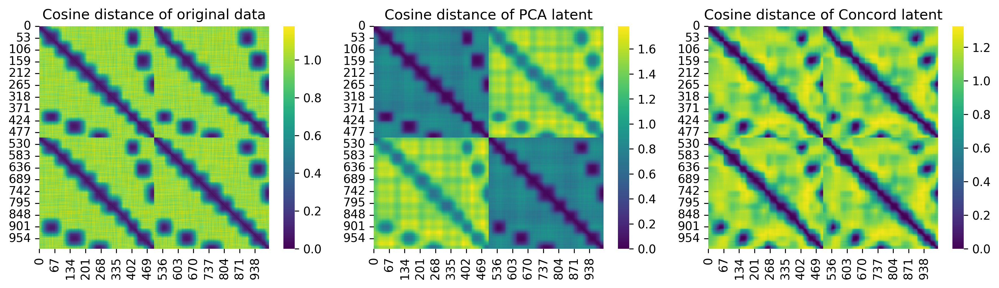

In [340]:
import seaborn as sns
fig, axes = plt.subplots(1, 3, figsize=(12, 3.5), dpi=300)
sns.heatmap(squareform(dist_original), cmap='viridis', ax=axes[0])
axes[0].set_title(f'{dist_metric.capitalize()} distance of original data')
sns.heatmap(squareform(dist_pca), cmap='viridis', ax=axes[1])
axes[1].set_title(f'{dist_metric.capitalize()} distance of PCA latent')
sns.heatmap(squareform(dist_concord), cmap='viridis', ax=axes[2])
axes[2].set_title(f'{dist_metric.capitalize()} distance of Concord latent')
plt.tight_layout()
plt.savefig(save_dir / f"{dist_metric}_distance_heatmaps_{file_suffix}.png")

**Normalized Stress**

In [341]:
import numpy as np
from scipy.spatial.distance import pdist

def normalized_stress(X_high, X_low):
    dist_high = pdist(X_high)
    dist_low = pdist(X_low)
    stress = np.sqrt(np.sum((dist_high - dist_low) ** 2) / np.sum(dist_high ** 2))
    return stress

stress_ccd_state = normalized_stress(adata_state.X, adata.obsm['Concord'])
print(f'Normalized Stress comparing state and Concord: {stress_ccd_state:.4f}')
stress_pca_state = normalized_stress(adata_state.X, adata.obsm['X_pca'])
print(f'Normalized Stress comparing state and PCA: {stress_pca_state:.4f}')
stress_ccd_batch = normalized_stress(adata.X, adata.obsm['Concord'])
print(f'Normalized Stress comparing batch and Concord: {stress_ccd_batch:.4f}')
stress_pca_batch = normalized_stress(adata.X, adata.obsm['X_pca'])
print(f'Normalized Stress comparing batch and PCA: {stress_pca_batch:.4f}')

Normalized Stress comparing state and Concord: 0.9261
Normalized Stress comparing state and PCA: 0.2560
Normalized Stress comparing batch and Concord: 0.9357
Normalized Stress comparing batch and PCA: 0.0001


**Correlation of overall distance structure**

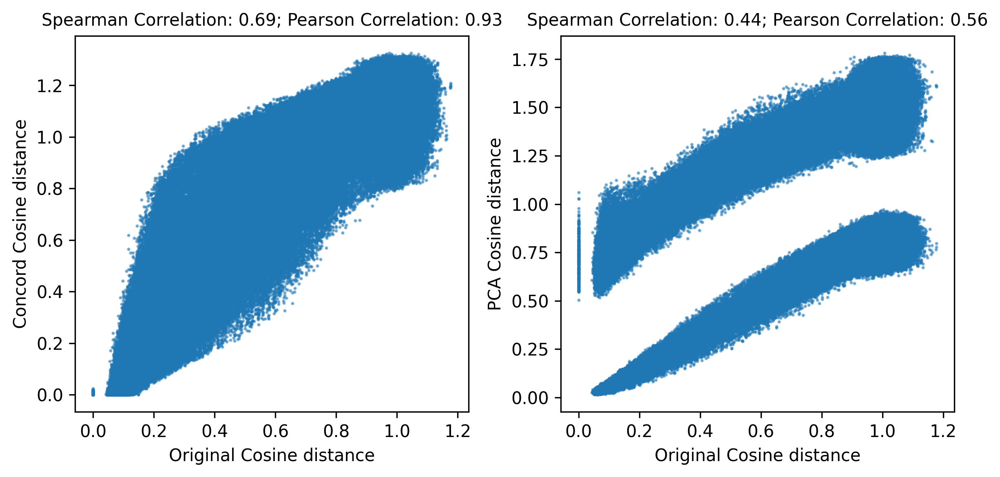

In [342]:
# Visualize the correlation between pairwise distances in original and latent space
import matplotlib.pyplot as plt
fig, axes = plt.subplots(1, 2, figsize=(8, 4), dpi=300)
axes[0].scatter(dist_original, dist_concord, s=1, alpha=0.5)
axes[0].set_title(f'Spearman Correlation: {spearmanr(dist_original, dist_concord)[0]:.2f}; Pearson Correlation: {pearsonr(dist_original, dist_concord)[0]:.2f}', fontsize=10)
axes[0].set_xlabel(f'Original {dist_metric.capitalize()} distance')
axes[0].set_ylabel(f'Concord {dist_metric.capitalize()} distance')
axes[1].scatter(dist_original, dist_pca, s=1, alpha=0.5)
axes[1].set_title(f'Spearman Correlation: {spearmanr(dist_original, dist_pca)[0]:.2f}; Pearson Correlation: {pearsonr(dist_original, dist_pca)[0]:.2f}', fontsize=10)
axes[1].set_xlabel(f'Original {dist_metric.capitalize()} distance')
axes[1].set_ylabel(f'PCA {dist_metric.capitalize()} distance')
plt.tight_layout()
plt.savefig(save_dir / f"{dist_metric}_distance_correlation_scatter_{file_suffix}.png")

**Should test the structure against clr_masking_ratio and clr_temperature, using gam/spline/loess fit.**

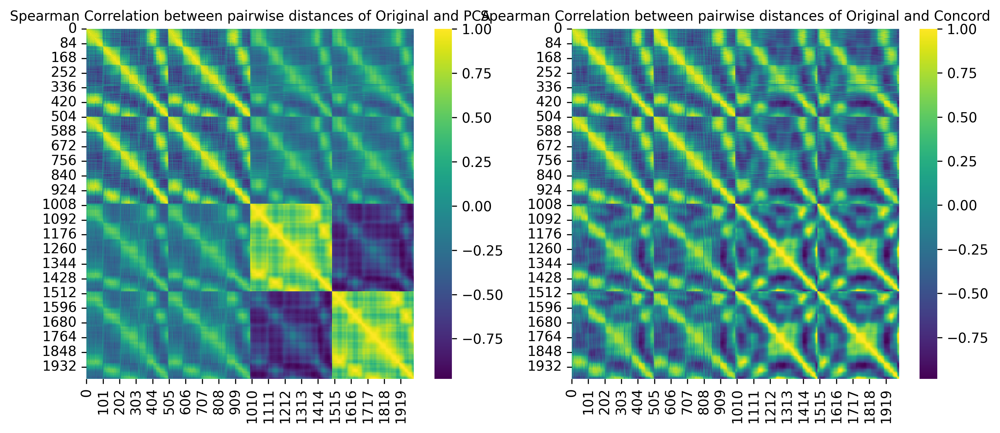

In [307]:
# Visualize distance Spearman correlation as heatmap
import seaborn as sns
corr_concord, _ = spearmanr(squareform(dist_original), squareform(dist_concord))
corr_batch, _ = spearmanr(squareform(dist_original), squareform(dist_pca))

fig, axes = plt.subplots(1, 2, figsize=(10, 4.5), dpi=300)
sns.heatmap(corr_batch, cmap='viridis', ax=axes[0])
axes[0].set_title(f'Spearman Correlation between pairwise distances of Original and PCA', fontsize=10)
sns.heatmap(corr_concord, cmap='viridis', ax=axes[1])
axes[1].set_title(f'Spearman Correlation between pairwise distances of Original and Concord', fontsize=10)
plt.tight_layout()
plt.savefig(save_dir / f"{dist_metric}_distance_spearman_corr_heatmaps_{file_suffix}.png")


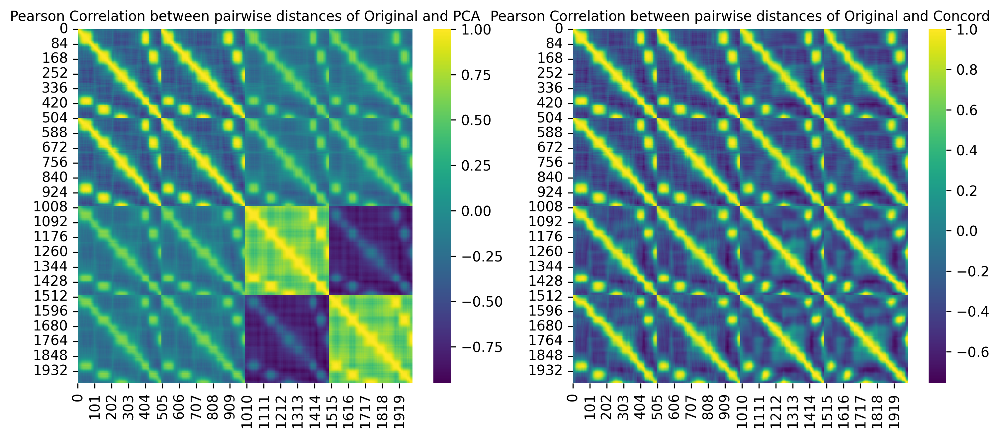

In [314]:
# Visualize Pearson correlation as heatmap
import seaborn as sns
corr_concord = np.corrcoef(squareform(dist_original), squareform(dist_concord))
corr_batch = np.corrcoef(squareform(dist_original), squareform(dist_pca))

fig, axes = plt.subplots(1, 2, figsize=(10, 4.5), dpi=300)
sns.heatmap(corr_batch, cmap='viridis', ax=axes[0])
axes[0].set_title(f'Pearson Correlation between pairwise distances of Original and PCA', fontsize=10)
sns.heatmap(corr_concord, cmap='viridis', ax=axes[1])
axes[1].set_title(f'Pearson Correlation between pairwise distances of Original and Concord', fontsize=10)
plt.tight_layout()
plt.savefig(save_dir / f"{dist_metric}_distance_pearson_corr_heatmaps_{file_suffix}.png")

**Mantel test**

In [345]:
from skbio.stats.distance import mantel
from scipy.spatial.distance import pdist, squareform

# Perform Mantel test
corr_sp_ccd, p_sp_ccd, _ = mantel(dist_original, dist_concord, method='spearman')
corr_sp_pca, p_sp_pca, _ = mantel(dist_original, dist_pca, method='spearman')
corr_pr_ccd, p_pr_ccd, _ = mantel(dist_original, dist_concord, method='pearson')
corr_pr_pca, p_pr_pca, _ = mantel(dist_original, dist_pca, method='pearson')

print(f'Mantel Test: Spearman Correlation: Concord: {corr_sp_ccd:.2f}, PCA: {corr_sp_pca:.2f}; p-value: Concord: {p_sp_ccd}, PCA: {p_sp_pca}')
print(f'Mantel Test: Pearson Correlation: Concord: {corr_pr_ccd:.2f}, PCA: {corr_pr_pca:.2f}; p-value: Concord: {p_pr_ccd}, PCA: {p_pr_pca}')


Mantel Test: Spearman Correlation: Concord: 0.69, PCA: 0.44; p-value: Concord: 0.001, PCA: 0.001
Mantel Test: Pearson Correlation: Concord: 0.93, PCA: 0.56; p-value: Concord: 0.001, PCA: 0.001


#### 2.3 Local vs distal Spearman correlation

In [354]:
from scipy.spatial.distance import pdist, squareform
from scipy.stats import spearmanr
import numpy as np

def local_vs_distal_spearman(X_high, X_low, local_percentile=25, distal_percentile=75, method='spearman'):
    # Step 1: Compute pairwise distances
    dist_high = pdist(X_high)  # Original space distances
    dist_low = pdist(X_low)    # Latent space distances

    # Step 2: Define a threshold based on the specified percentile
    distance_threshold_local = np.percentile(dist_high, local_percentile)
    distance_threshold_distal = np.percentile(dist_high, distal_percentile)

    # Step 3: Separate distances into local and distal categories
    local_mask = dist_high <= distance_threshold_local
    distal_mask = dist_high > distance_threshold_distal

    # Step 4: Compute Spearman correlations for local and distal distances
    if method == 'spearman':
        local_spearman, _ = spearmanr(dist_high[local_mask], dist_low[local_mask])
        distal_spearman, _ = spearmanr(dist_high[distal_mask], dist_low[distal_mask])
    elif method == 'pearson':
        local_spearman, _ = pearsonr(dist_high[local_mask], dist_low[local_mask])
        distal_spearman, _ = pearsonr(dist_high[distal_mask], dist_low[distal_mask])

    return local_spearman, distal_spearman

# Example usage
local_sp_ccd, distal_sp_ccd = local_vs_distal_spearman(adata_state.X, adata.obsm['Concord'], method='spearman')
local_sp_pca, distal_sp_pca = local_vs_distal_spearman(adata_state.X, adata.obsm['X_pca'], method='spearman')
print(f'Local Spearman Correlation: Concord: {local_sp_ccd:.4f}, PCA: {local_sp_pca:.4f}')
print(f'Distal Spearman Correlation: Concord: {distal_sp_ccd:.4f}, PCA: {distal_sp_pca:.4f}')
local_pr_ccd, distal_pr_ccd = local_vs_distal_spearman(adata_state.X, adata.obsm['Concord'], method='pearson')
local_pr_pca, distal_pr_pca = local_vs_distal_spearman(adata_state.X, adata.obsm['X_pca'], method='pearson')
print(f'Local Pearson Correlation: Concord: {local_pr_ccd:.4f}, PCA: {local_pr_pca:.4f}')
print(f'Distal Pearson Correlation: Concord: {distal_pr_ccd:.4f}, PCA: {distal_pr_pca:.4f}')

Local Spearman Correlation: Concord: 0.8604, PCA: 0.4826
Distal Spearman Correlation: Concord: -0.0312, PCA: 0.3466
Local Pearson Correlation: Concord: 0.8585, PCA: 0.4015
Distal Pearson Correlation: Concord: -0.0242, PCA: 0.1141


# How those associate with neighborhood size and proportion. 

#### 2.4 Trustworthiness (Local neighborhood/structure preservation)

In [325]:
from sklearn.manifold import trustworthiness

n_neighbors = 10  # Adjust as needed

trust_ccd_batch = trustworthiness(adata.X, adata.obsm['Concord'], n_neighbors=n_neighbors)
trust_pca_batch = trustworthiness(adata.X, adata.obsm['X_pca'], n_neighbors=n_neighbors)
trust_ccd_state = trustworthiness(adata_state.X, adata.obsm['Concord'], n_neighbors=n_neighbors)
trust_pca_state = trustworthiness(adata_state.X, adata.obsm['X_pca'], n_neighbors=n_neighbors)

print(f"Trustworthiness of Concord vs batch data: {trust_ccd_batch}")
print(f"Trustworthiness of PCA vs batch data: {trust_pca_batch}")
print(f"Trustworthiness of Concord vs state data: {trust_ccd_state}")
print(f"Trustworthiness of PCA vs state data: {trust_pca_state}")

Trustworthiness of Concord vs batch data: 0.8923264601320468
Trustworthiness of PCA vs batch data: 0.9999889283900457
Trustworthiness of Concord vs state data: 0.9941431183341798
Trustworthiness of PCA vs state data: 0.9923413915693245


In [348]:
# Plot trustworthiness as a function of number of neighbors
import numpy as np
import matplotlib.pyplot as plt

n_neighbors = np.arange(10, 500, 10)
trust_ccd = [trustworthiness(adata_state.X, adata.obsm['Concord'], n_neighbors=n) for n in n_neighbors]
trust_pca = [trustworthiness(adata_state.X, adata.obsm['X_pca'], n_neighbors=n) for n in n_neighbors]


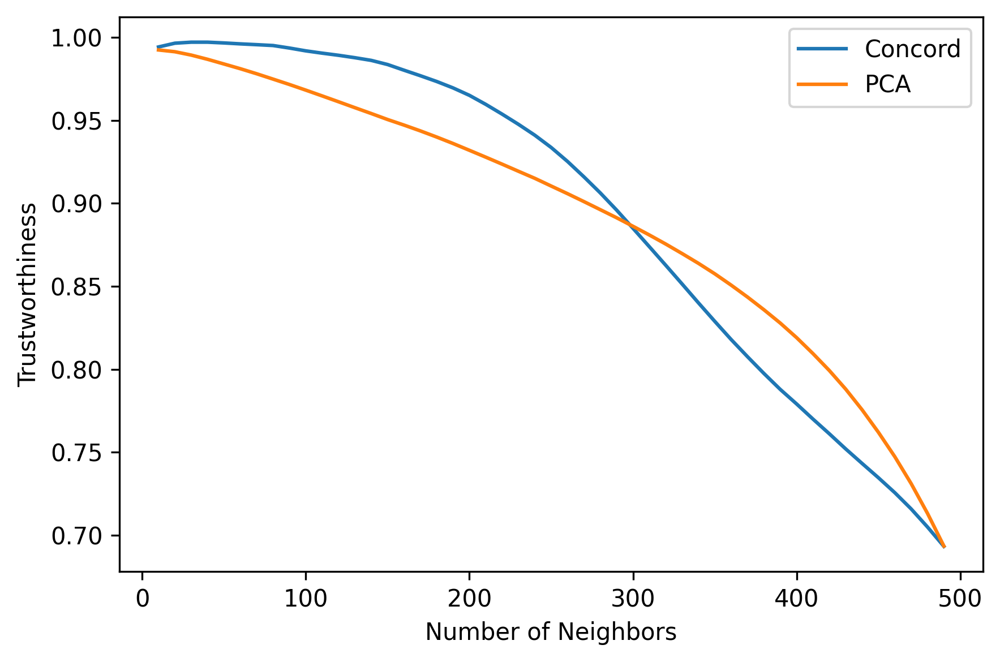

In [349]:
# Plot trustworthiness as a function of number of neighbors
plt.figure(figsize=(6, 4), dpi=300)
plt.plot(n_neighbors, trust_ccd, label='Concord')
plt.plot(n_neighbors, trust_pca, label='PCA')
plt.xlabel('Number of Neighbors')
plt.ylabel('Trustworthiness')
plt.legend()
plt.tight_layout()

plt.savefig(save_dir / f"trustworthiness_{file_suffix}.png")
